# SuperResolution

### Data reading





In [ ]:
from glob import glob
import matplotlib.pyplot as plt

In [ ]:
!pip install kaggle

In [ ]:
'''here your kaggle token needs to be uploaded'''
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"jdrzejmiczke","key":"a9a3a14d6026d5df61432ecc87d5cc8b"}'}

In [ ]:
!mkdir ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle datasets download andrewmvd/animal-faces

Dataset URL: https://www.kaggle.com/datasets/andrewmvd/animal-faces
License(s): Attribution-NonCommercial 4.0 International (CC BY-NC 4.0)
 97% 676M/696M [00:04<00:00, 228MB/s]
100% 696M/696M [00:04<00:00, 172MB/s]


In [ ]:
!unzip animal-faces.zip

Streaming output truncated to the last 5000 lines.
  inflating: afhq/train/wild/flickr_wild_001378.jpg  
  inflating: afhq/train/wild/flickr_wild_001379.jpg  
  inflating: afhq/train/wild/flickr_wild_001380.jpg  
  inflating: afhq/train/wild/flickr_wild_001381.jpg  
  inflating: afhq/train/wild/flickr_wild_001382.jpg  
  inflating: afhq/train/wild/flickr_wild_001384.jpg  
  inflating: afhq/train/wild/flickr_wild_001385.jpg  
  inflating: afhq/train/wild/flickr_wild_001386.jpg  
  inflating: afhq/train/wild/flickr_wild_001387.jpg  
  inflating: afhq/train/wild/flickr_wild_001388.jpg  
  inflating: afhq/train/wild/flickr_wild_001389.jpg  
  inflating: afhq/train/wild/flickr_wild_001390.jpg  
  inflating: afhq/train/wild/flickr_wild_001391.jpg  
  inflating: afhq/train/wild/flickr_wild_001392.jpg  
  inflating: afhq/train/wild/flickr_wild_001393.jpg  
  inflating: afhq/train/wild/flickr_wild_001394.jpg  
  inflating: afhq/train/wild/flickr_wild_001395.jpg  
  inflating: afhq/train/wild/fl

In [ ]:
!rm animal-faces.zip

### Visualization of the examples in the dataset

In [ ]:
from PIL import Image


TRAIN_CATS_DIR = 'afhq/train/cats'
VAL_CATS_DIR = 'afhq/val/cats'
TRAIN_DOGS_DIR = 'afhq/train/dogs'
VAL_DOGS_DIR = 'afhq/val/dogs'
TRAIN_WILD_DIR = 'afhq/train/wild'
VAL_WILD_DIR = 'afhq/val/wild'



dogs_train_files = glob('afhq/train/dog/*.jpg')
cats_train_files = glob('afhq/train/cat/*.jpg')
wild_train_files = glob('afhq/train/wild/*.jpg')
dogs_val_files = glob('afhq/val/dog/*.jpg')
cats_val_files = glob('afhq/val/cat/*.jpg')
wild_val_files = glob('afhq/val/wild/*.jpg')


all_files = dogs_train_files + cats_train_files + wild_train_files + dogs_val_files + cats_val_files + wild_val_files




print(len(all_files))


16130


In [ ]:
dogImg = plt.imread(dogs_train_files[0])
catImg = plt.imread(cats_train_files[0])
wildImg = plt.imread(wild_train_files[0])
dogImgVal = plt.imread(dogs_val_files[0])
catImgVal = plt.imread(cats_val_files[0])
wildImgVal = plt.imread(wild_val_files[0])
print(dogImg.shape, catImg.shape, wildImg.shape)
print(dogImgVal.shape, catImgVal.shape, wildImgVal.shape)

(512, 512, 3) (512, 512, 3) (512, 512, 3)
(512, 512, 3) (512, 512, 3) (512, 512, 3)


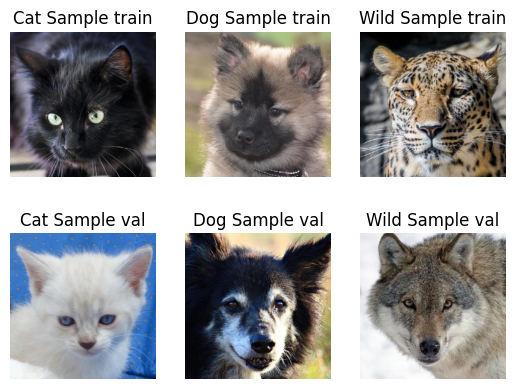

In [ ]:
fig, axs = plt.subplots(2,3)
axs[0][0].imshow(catImg)
axs[0][1].imshow(dogImg)
axs[0][2].imshow(wildImg)
axs[0][0].axis('off')
axs[0][1].axis('off')
axs[0][2].axis('off')
axs[0][0].set_title('Cat Sample train')
axs[0][1].set_title('Dog Sample train')
axs[0][2].set_title('Wild Sample train')
axs[1][0].imshow(catImgVal)
axs[1][1].imshow(dogImgVal)
axs[1][2].imshow(wildImgVal)
axs[1][0].axis('off')
axs[1][1].axis('off')
axs[1][2].axis('off')
axs[1][0].set_title('Cat Sample val')
axs[1][1].set_title('Dog Sample val')
axs[1][2].set_title('Wild Sample val')
plt.show()

### Creating mixed  dataset with examples of all kinds

Here we create a training set directory comprising of  500 examples of each type: cat,dog,wildlife  and validation directory comprising of 100 examples of each class

In [ ]:
import os
import shutil


TRAIN_CATS_DIR = 'afhq/train/cat'
VAL_CATS_DIR = 'afhq/val/cat'
TRAIN_DOGS_DIR = 'afhq/train/dog'
VAL_DOGS_DIR = 'afhq/val/dog'
TRAIN_WILD_DIR = 'afhq/train/wild'
VAL_WILD_DIR = 'afhq/val/wild'

ALL_TRAIN_DIR = 'afhq/ALL_training'
ALL_VAL_DIR = 'afhq/ALL_validation'


os.makedirs(ALL_TRAIN_DIR, exist_ok=True)
os.makedirs(ALL_VAL_DIR, exist_ok=True)


def copy_files(src_dir, dest_dir, count):
    files = sorted(os.listdir(src_dir))[:count]
    for file in files:
        src_file = os.path.join(src_dir, file)
        dest_file = os.path.join(dest_dir, file)
        shutil.copy(src_file, dest_file)


print("Processing training dataset...")
for class_dir in [TRAIN_CATS_DIR, TRAIN_DOGS_DIR, TRAIN_WILD_DIR]:
    class_name = os.path.basename(class_dir)
    dest_dir = ALL_TRAIN_DIR
    os.makedirs(dest_dir, exist_ok=True)
    copy_files(class_dir, dest_dir, 500)


print("Processing validation dataset...")
for class_dir in [VAL_CATS_DIR, VAL_DOGS_DIR, VAL_WILD_DIR]:
    class_name = os.path.basename(class_dir)
    dest_dir = ALL_VAL_DIR
    os.makedirs(dest_dir, exist_ok=True)
    copy_files(class_dir, dest_dir, 100)



Processing training dataset...
Processing validation dataset...
Files have been successfully combined into ALL_train and ALL_val directories.


# Model for Superesolution
The model that we use for the superesolution here is esrgan model.

- Firstly we train solely the generator which consists of convolutional layeres blocks with residual connections and tf.nn.depth_to_space upscaling which upscales the spatial resolution from the depth channels and at the end a convolution layer

- At the generator stage we utilize two loss functions, one the simple L1 between the upscaled and ground truth and second: perceptual loss basing on the features extracted by pretrained vgg network
- The second function is to keep the feature from the original image and prevents creating bigger batches with blended unifrom color, which happens with sole L1 as it looses small details

- the model works on the input downscaled x2 in each dimensions, the downscaling is done with the interlinaer method

### Defining generator model

In [ ]:
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow import keras



class DepthToSpace(layers.Layer):
    def __init__(self, block_size, **kwargs):
        super(DepthToSpace, self).__init__(**kwargs)
        self.block_size = block_size

    def call(self, inputs):
        return tf.nn.depth_to_space(inputs, self.block_size)

tf.keras.utils.get_custom_objects()['DepthToSpace'] = DepthToSpace

def residual_dense_block(inputs, num_features=64, growth_channels=32):
    x = layers.Conv2D(growth_channels, kernel_size=3, padding='same', activation='relu')(inputs)
    x = layers.Conv2D(growth_channels, kernel_size=3, padding='same', activation='relu')(x)
    x = layers.Conv2D(num_features, kernel_size=3, padding='same')(x)
    return layers.Add()([inputs, x])



def rrdb_block(x, num_features):
    residual = x
    x = layers.Conv2D(num_features, kernel_size=3, padding='same')(x)
    x = layers.ReLU()(x)
    x = layers.Conv2D(num_features, kernel_size=3, padding='same')(x)
    x = layers.ReLU()(x)
    x = layers.Conv2D(num_features, kernel_size=3, padding='same')(x)
    x = layers.Add()([x, residual])
    return x

def esrgan_generator(num_features=32, num_rrdb_blocks=15, scale_factor=2):
    inputs = layers.Input(shape=(None, None, 3))
    x = layers.Conv2D(num_features, kernel_size=3, padding='same')(inputs)
    rrdb_trunk = x
    for _ in range(num_rrdb_blocks):
        rrdb_trunk = rrdb_block(rrdb_trunk, num_features)
    x = layers.Add()([x, rrdb_trunk])

    for _ in range(int(scale_factor / 2)):
        x = layers.Conv2D(num_features * 4, kernel_size=3, padding='same')(x)
        x = DepthToSpace(block_size=2)(x)
        x = layers.ReLU()(x)

    outputs = layers.Conv2D(3, kernel_size=3, padding='same', activation='sigmoid')(x)

    return tf.keras.Model(inputs, outputs)



def content_loss(hr_image, sr_image):
    return tf.reduce_mean(tf.abs(hr_image - sr_image))

def perceptual_loss(hr_image, sr_image):
    sr_features = feature_extractor(sr_image)
    hr_features = feature_extractor(hr_image)
    return tf.reduce_mean(tf.abs(hr_features - sr_features))

### Creating generator instance and  vgg instance

In [ ]:








import tensorflow as tf
from tensorflow.keras.losses import MeanAbsoluteError


generator = esrgan_generator()

generator.summary()


optimizer = tf.keras.optimizers.Adam(learning_rate=1e-4)
content_loss_fn = MeanAbsoluteError()

vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
vgg.trainable = False
feature_extractor = tf.keras.Model(inputs=vgg.input, outputs=vgg.get_layer('block5_conv4').output)

def perceptual_loss(hr_image, sr_image):
    sr_features = feature_extractor(sr_image)
    hr_features = feature_extractor(hr_image)
    return tf.reduce_mean(tf.abs(hr_features - sr_features))

# Training step
@tf.function
def train_step(lr_images, hr_images):
    with tf.GradientTape() as tape:
        sr_images = generator(lr_images, training=True)
        content_loss = content_loss_fn(hr_images, sr_images)
        perceptual_loss_value = perceptual_loss(hr_images, sr_images)
        total_loss = content_loss + perceptual_loss_value

    gradients = tape.gradient(total_loss, generator.trainable_variables)
    optimizer.apply_gradients(zip(gradients, generator.trainable_variables))
    return total_loss



Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, None, None, 3)  │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d (Conv2D)           │ (None, None, None, 32) │            896 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_1 (Conv2D)         │ (None, None, None, 32) │          9,248 │ conv2d[0][0]           │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ re_lu (ReLU)              │ (None, None, None, 32) │              0 │ conv2d_1[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_2 (Conv2D)         │ (None, None, None, 32) │          9,248 │ re_lu[0][0]            │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ re_lu_1 (ReLU)            │ (None, None, None, 32) │              0 │ conv2d_2[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_3 (Conv2D)         │ (None, None, None, 32) │          9,248 │ re_lu_1[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ add (Add)                 │ (None, None, None, 32) │              0 │ conv2d_3[0][0],        │
│                           │                        │                │ conv2d[0][0]           │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_4 (Conv2D)         │ (None, None, None, 32) │          9,248 │ add[0][0]              │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ re_lu_2 (ReLU)            │ (None, None, None, 32) │              0 │ conv2d_4[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_5 (Conv2D)         │ (None, None, None, 32) │          9,248 │ re_lu_2[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ re_lu_3 (ReLU)            │ (None, None, None, 32) │              0 │ conv2d_5[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_6 (Conv2D)         │ (None, None, None, 32) │          9,248 │ re_lu_3[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ add_1 (Add)               │ (None, None, None, 32) │              0 │ conv2d_6[0][0],        │
│                           │                        │                │ add[0][0]              │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_7 (Conv2D)         │ (None, None, None, 32) │          9,248 │ add_1[0][0]            │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ re_lu_4 (ReLU)            │ (None, None, None, 32) │              0 │ conv2d_7[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_8 (Conv2D)         │ (None, None, None, 32) │          9,248 │ re_lu_4[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ re_lu_5 (ReLU)            │ (None, None, None, 32) │              0 │ conv2d_8[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_9 (Conv2D)    

 Total params: 454,915 (1.74 MB)

 Trainable params: 454,915 (1.74 MB)

 Non-trainable params: 0 (0.00 B)

### Defining the training and validation functions

Here we define the trianing function for the generator model, we also include the validation on the validation set, and callback of early stoping in case the model would overfit.

In [ ]:
import numpy as np


def train_generator_with_validation(train_dataset, val_dataset, epochs, patience=2):
    best_val_loss = float('inf')
    patience_counter = 0

    for epoch in range(epochs):
        for lr_images, hr_images in train_dataset:
            train_loss = train_step(lr_images, hr_images)


        val_losses = []
        for lr_images, hr_images in val_dataset:
            sr_images = generator(lr_images, training=False)
            content_loss = content_loss_fn(hr_images, sr_images)
            perceptual_loss_value = perceptual_loss(hr_images, sr_images)
            val_loss = content_loss + perceptual_loss_value
            val_losses.append(val_loss.numpy())

        avg_val_loss = np.mean(val_losses)

        print(f"Epoch {epoch + 1}/{epochs}, Train Loss: {train_loss.numpy()}, Validation Loss: {avg_val_loss}")

        if epoch >= 3:
          if avg_val_loss < 0.98 * best_val_loss:
              best_val_loss = avg_val_loss
              patience_counter = 0
              print("Validation loss improved, saving model...")
              generator.save("best_generator.h5")
          else:
              patience_counter += 1
              print(f"Validation loss did not improve for {patience_counter} epochs")

          if patience_counter >= patience:
              print("Early stopping triggered")
              break


### Dataset creation
Here are created , dataset and saved in the appriopriate directories.

In [ ]:
import tensorflow as tf
from glob import glob
import cv2

def preprocess_image(file_path, hr_size=(512, 512), scale_factor=4):
    """Preprocess an image: load, decode, resize, and create LR-HR pair."""
    hr_image = tf.io.read_file(file_path)
    hr_image = tf.image.decode_jpeg(hr_image, channels=3)
    print(hr_image.shape)


    lr_size = (hr_size[0] // scale_factor, hr_size[1] // scale_factor)
    lr_image = tf.image.resize(hr_image, lr_size)
    print(lr_image.shape)
    print(hr_image.shape)

    return tf.cast(lr_image, tf.float32) / 255.0, tf.cast(hr_image, tf.float32) / 255.0

def create_dataset(directory, batch_size=1,number_ex = 1500, hr_size=(512, 512), scale_factor=2):
    file_paths = glob(f"{directory}/*.jpg")
    file_paths = file_paths[:number_ex]
    dataset = tf.data.Dataset.from_tensor_slices(file_paths)
    dataset = dataset.map(lambda x: preprocess_image(x, hr_size, scale_factor),
                          num_parallel_calls=tf.data.AUTOTUNE)
    dataset = dataset.shuffle(buffer_size=1000)
    dataset = dataset.batch(batch_size)
    dataset = dataset.prefetch(buffer_size=tf.data.AUTOTUNE)
    return dataset


train_dataset = create_dataset('afhq/ALL_training', batch_size=8)
val_dataset = create_dataset('afhq/ALL_validation', batch_size=8,number_ex = 300)
print(len(val_dataset))


(None, None, 3)
(256, 256, 3)
(None, None, 3)
(None, None, 3)
(256, 256, 3)
(None, None, 3)
38


## Training
The model is created however we overshoot with the epoch number considering the deep architecture of the model, and due to time reasons we had to early stop the training.

In [ ]:
train_generator_with_validation(train_dataset, val_dataset, 50, patience=2)

Epoch 1/50, Train Loss: 0.08085131645202637, Validation Loss: 0.07433421164751053
Epoch 2/50, Train Loss: 0.08168654143810272, Validation Loss: 0.05573933199048042
Epoch 3/50, Train Loss: 0.05622673034667969, Validation Loss: 0.043311845511198044


Epoch 4/50, Train Loss: 0.04511387646198273, Validation Loss: 0.04220164567232132
Validation loss improved, saving model...


Epoch 5/50, Train Loss: 0.03891443461179733, Validation Loss: 0.038221005350351334
Validation loss improved, saving model...


KeyboardInterrupt: 

### visualization of the results
We visualize and empirically asses the model performance and compare it with  the non deep learning based method on linear interpolation. Since the state of the model now is only an intermediary step, we just take one random image from the train set and  one random from the wild set(set with the biggest interset variability) to look whether the training created and visible effect.

LR Image Shape: (256, 256, 3)
HR Image Shape: (512, 512, 3)


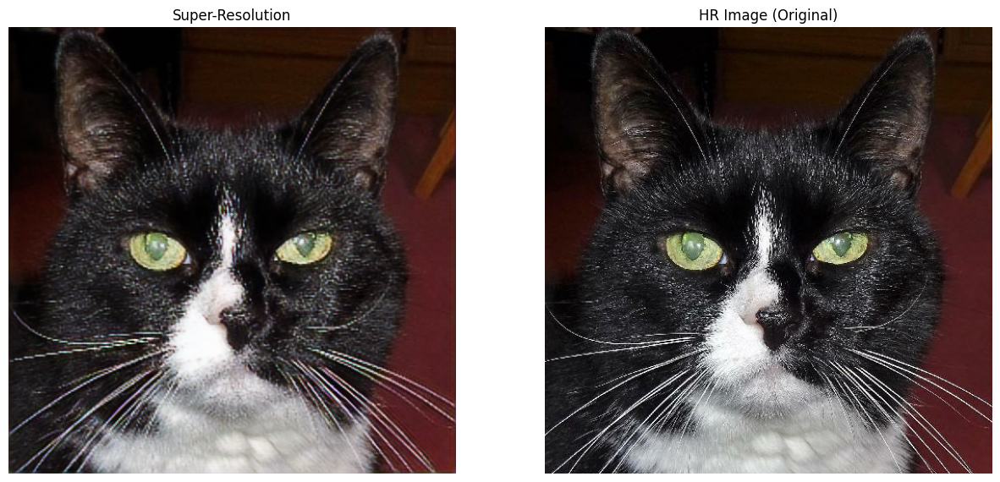

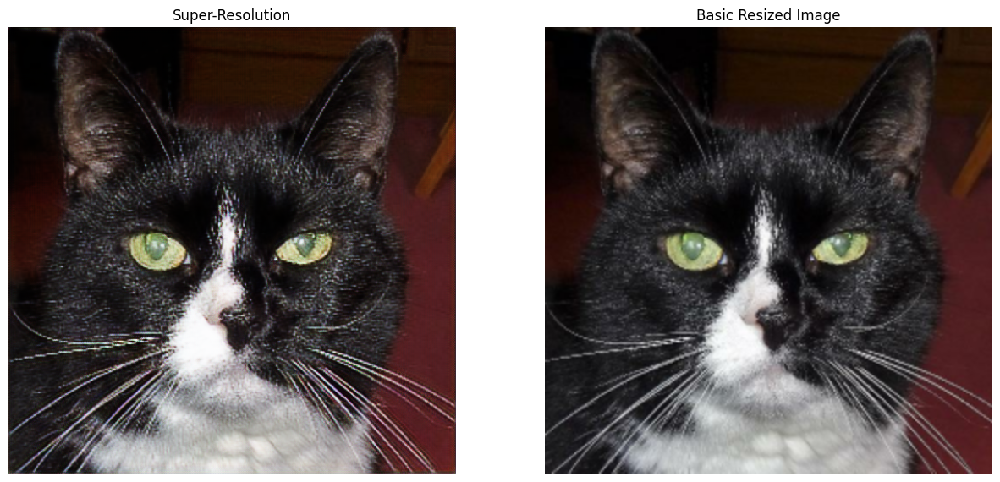

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf

for lr_images, hr_images in train_dataset.take(1):
    lr_image = lr_images[0]
    hr_image = hr_images[0]

    print("LR Image Shape:", lr_image.shape)
    print("HR Image Shape:", hr_image.shape)


    sr_image = generator(tf.expand_dims(lr_image, axis=0), training=False)
    lr_image_numpy = lr_image.numpy()
    basic_sr_image = cv2.resize(lr_image_numpy, (512, 512))
    sr_image = tf.squeeze(sr_image, axis=0).numpy()

    fig, axs = plt.subplots(1, 2, figsize=(15, 7))


    axs[0].imshow(sr_image)
    axs[0].set_title("Super-Resolution")
    axs[0].axis("off")

    axs[1].imshow(hr_image)
    axs[1].set_title("HR Image (Original)")
    axs[1].axis("off")

    plt.show()


    fig, axs = plt.subplots(1, 2, figsize=(15, 7))


    axs[0].imshow(sr_image)
    axs[0].set_title("Super-Resolution")
    axs[0].axis("off")

    axs[1].imshow(basic_sr_image)
    axs[1].set_title("Basic Resized Image")
    axs[1].axis("off")

    plt.show()



(None, None, 3)
(256, 256, 3)
(None, None, 3)
LR Image Shape: (256, 256, 3)
HR Image Shape: (512, 512, 3)


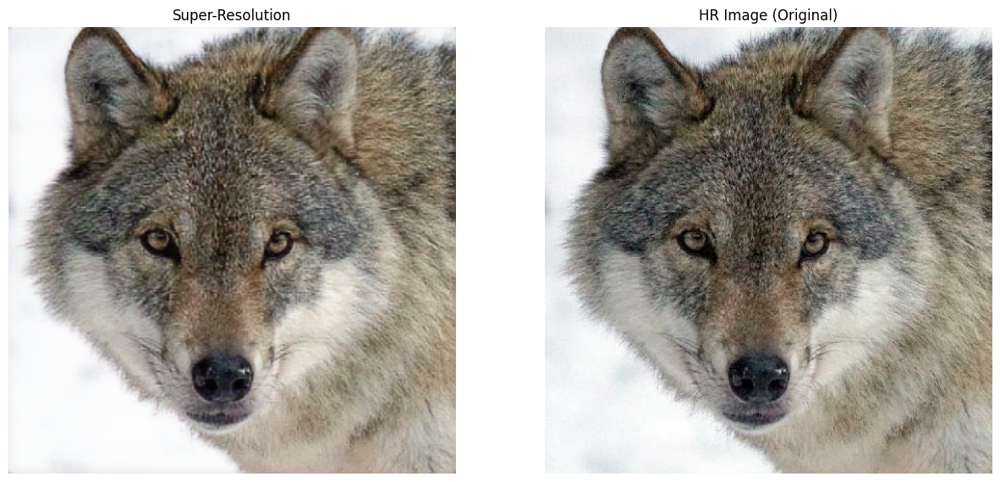

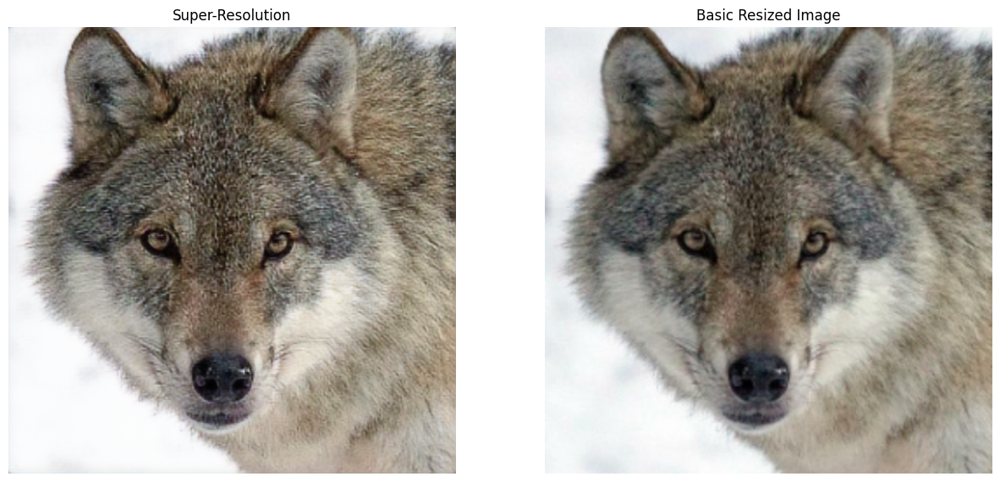

In [ ]:
wild_dataset = create_dataset('afhq/val/wild', batch_size=1,number_ex = 1)
for lr_images, hr_images in wild_dataset.take(1):
    lr_image = lr_images[0]
    hr_image = hr_images[0]

    print("LR Image Shape:", lr_image.shape)
    print("HR Image Shape:", hr_image.shape)


    sr_image = generator(tf.expand_dims(lr_image, axis=0), training=False)
    lr_image_numpy = lr_image.numpy()
    basic_sr_image = cv2.resize(lr_image_numpy, (512, 512))
    sr_image = tf.squeeze(sr_image, axis=0).numpy()


    fig, axs = plt.subplots(1, 2, figsize=(15, 7))

    axs[0].imshow(sr_image)
    axs[0].set_title("Super-Resolution")
    axs[0].axis("off")


    axs[1].imshow(hr_image)
    axs[1].set_title("HR Image (Original)")
    axs[1].axis("off")

    plt.show()


    fig, axs = plt.subplots(1, 2, figsize=(15, 7))


    axs[0].imshow(sr_image)
    axs[0].set_title("Super-Resolution")
    axs[0].axis("off")


    axs[1].imshow(basic_sr_image)
    axs[1].set_title("Basic Resized Image")
    axs[1].axis("off")

    plt.show()


### Conclusion

It already seem to perform better than the interlinear approximation. However it is cleary discernable from the high resolution image, as it creates a substantial amount of noise.
Thats why we need to employ the adversarial training with the discriminator

### Adversarial training with discriminator

### discriminator architecture definition


The discriminator is network with  convolutional layers, with final layer of sigmoid to gather the network output  and cast the value to (0,1) range, 0 for the fake generated images and 1 for the true high resolution images.



In [ ]:
import tensorflow as tf
from tensorflow.keras import layers

def esrgan_discriminator(num_features=64):
    inputs = layers.Input(shape=(512, 512, 3))
    x = layers.Conv2D(num_features, kernel_size=3, strides=2, padding='same')(inputs)
    x = layers.LeakyReLU(alpha=0.2)(x)

    x = layers.Conv2D(num_features * 2, kernel_size=3, strides=2, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(alpha=0.2)(x)

    x = layers.Conv2D(num_features * 4, kernel_size=3, strides=2, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(alpha=0.2)(x)

    x = layers.Conv2D(num_features * 8, kernel_size=3, strides=2, padding='same')(x)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(alpha=0.2)(x)

    x = layers.Flatten()(x)
    x = layers.Dense(1, activation='sigmoid')(x)

    return tf.keras.Model(inputs, x)

discriminator = esrgan_discriminator()
discriminator.summary()




binary_cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

# def adversarial_loss(fake_output):
#     return binary_cross_entropy(tf.ones_like(fake_output), fake_output)


/usr/local/lib/python3.11/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)           │ (None, 512, 512, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_48 (Conv2D)                   │ (None, 256, 256, 64)        │           1,792 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu (LeakyReLU)              │ (None, 256, 256, 64)        │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_49 (Conv2D)                   │ (None, 128, 128, 128)       │          73,856 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 128, 128, 128)       │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_1 (LeakyReLU)            │ (None, 128, 128, 128)       │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_50 (Conv2D)                   │ (None, 64, 64, 256)         │         295,168 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 64, 64, 256)         │           1,024 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_2 (LeakyReLU)            │ (None, 64, 64, 256)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_51 (Conv2D)                   │ (None, 32, 32, 512)         │       1,180,160 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 32, 32, 512)         │           2,048 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_3 (LeakyReLU)            │ (None, 32, 32, 512)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 524288)              │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 1)                   │         524,289 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 2,078,849 (7.93 MB)

 Trainable params: 2,077,057 (7.92 MB)

 Non-trainable params: 1,792 (7.00 KB)

### gan training definition


Here the Gan training function are defined.
The generator uses additional loss parameter-adversarial loss during the training. The adversarial loss indicates how good  the discriminator was in detecting the false image,s the more sure it was about the fakeness of the images the bigger the loss for the generator.
During the validation phase it is not used therefore we can compare the validation performance with the generator when it was used alone

In [ ]:
def train_generator_only(dataset, val_dataset, epochs,generator,generator_optimizer):
    for epoch in range(epochs):
        for lr_images, hr_images in dataset:
            with tf.GradientTape() as tape:
                sr_images = generator(lr_images, training=True)
                content_loss_value = content_loss_fn(hr_images, sr_images)
                perceptual_loss_value = perceptual_loss(hr_images, sr_images)
                total_loss = content_loss_value + perceptual_loss_value

            gradients = tape.gradient(total_loss, generator.trainable_variables)
            generator_optimizer.apply_gradients(zip(gradients, generator.trainable_variables))
        validate_generator(val_dataset)

        print(f"Epoch {epoch + 1}, Generator Loss: {total_loss.numpy()}")

def validate_generator(val_dataset,generator):
    total_val_loss = 0
    for lr_images, hr_images in val_dataset:
        sr_images = generator(lr_images, training=False)
        content_loss_value = content_loss_fn(hr_images, sr_images)
        perceptual_loss_value = perceptual_loss(hr_images, sr_images)
        val_loss = content_loss_value + perceptual_loss_value
        total_val_loss += val_loss

    print(f"Validation Loss: {total_val_loss.numpy() / len(val_dataset)}")

### The discriminator loss
it is the binary crossentropy between the set of real and fake images and it's prediction about realness of the images. So the more pictures it predict right and the more sure it is the lesser the loss

In [ ]:
def adversarial_loss(d_real, d_fake):
    real_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.ones_like(d_real), d_real)
    fake_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.zeros_like(d_fake), d_fake)
    return (real_loss + fake_loss) / 2
def generator_loss(d_fake, content_loss, perceptual_loss):
    return content_loss + perceptual_loss + 0.001 * tf.reduce_mean(tf.abs(d_fake))
generator_optimizer = tf.keras.optimizers.Adam(learning_rate=1e-4)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=1e-4)
@tf.function
def train_step_adversarial(lr_images, hr_images):
    with tf.GradientTape() as tape_gen, tf.GradientTape() as tape_disc:
        sr_images = generator(lr_images, training=True)
        d_real = discriminator(hr_images, training=True)
        d_fake = discriminator(sr_images, training=True)
        content_loss_value = content_loss_fn(hr_images, sr_images)
        perceptual_loss_value = perceptual_loss(hr_images, sr_images)
        gen_loss = generator_loss(d_fake, content_loss_value, perceptual_loss_value)
        gradients_gen = tape_gen.gradient(gen_loss, generator.trainable_variables)
        generator_optimizer.apply_gradients(zip(gradients_gen, generator.trainable_variables))
        disc_loss_value = adversarial_loss(d_real, d_fake)
        gradients_disc = tape_disc.gradient(disc_loss_value, discriminator.trainable_variables)
        discriminator_optimizer.apply_gradients(zip(gradients_disc, discriminator.trainable_variables))

    return gen_loss, disc_loss_value

def train_with_adversarial(dataset, val_dataset, epochs):
    for epoch in range(epochs):
        for lr_images, hr_images in dataset:
            gen_loss, disc_loss = train_step_adversarial(lr_images, hr_images)
        validate_generator(val_dataset,generator)

        print(f"Epoch {epoch + 1}, Generator Loss: {gen_loss.numpy()}, Discriminator Loss: {disc_loss.numpy()}")


### actual gan training

In [ ]:
train_with_adversarial(train_dataset, val_dataset, 20)

/usr/local/lib/python3.11/dist-packages/keras/src/backend/tensorflow/nn.py:707: UserWarning: "`binary_crossentropy` received `from_logits=True`, but the `output` argument was produced by a Sigmoid activation and thus does not represent logits. Was this intended?
  output, from_logits = _get_logits(


Validation Loss: 0.04008935940893073
Epoch 1, Generator Loss: 0.034687403589487076, Discriminator Loss: 0.0010827817022800446
Validation Loss: 0.04585421712774979
Epoch 2, Generator Loss: 0.03818126767873764, Discriminator Loss: 0.0002904902503360063
Validation Loss: 0.03491791298514918
Epoch 3, Generator Loss: 0.053486257791519165, Discriminator Loss: 9.555918722981005e-08
Validation Loss: 0.03665817097613686
Epoch 4, Generator Loss: 0.03733622282743454, Discriminator Loss: 0.011051452718675137
Validation Loss: 0.03358339949658042
Epoch 5, Generator Loss: 0.03492657095193863, Discriminator Loss: 1.0140807082947845e-09
Validation Loss: 0.032440631013167534
Epoch 6, Generator Loss: 0.025190625339746475, Discriminator Loss: 3.132473284495063e-05
Validation Loss: 0.03360535282837717
Epoch 7, Generator Loss: 0.02962631545960903, Discriminator Loss: 1.4125354290008545


KeyboardInterrupt: 

### Early stopping

Again it had to be stoppped earlier due to  the exploitation of the computation resources. It seemed promising as  because as validation numbers show, the generator trained with the discriminator  performed better on the validaiton set than the generator alone

### visualization after gan training

LR Image Shape: (256, 256, 3)
HR Image Shape: (512, 512, 3)


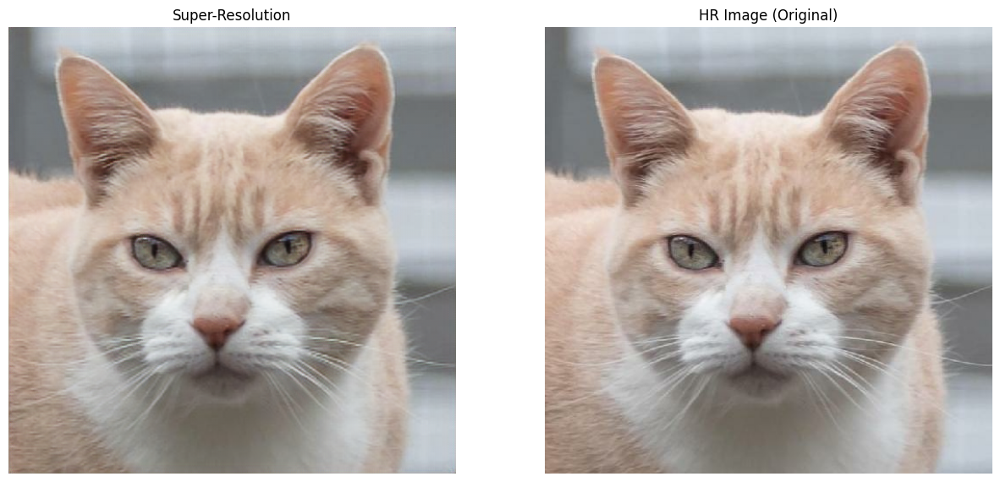

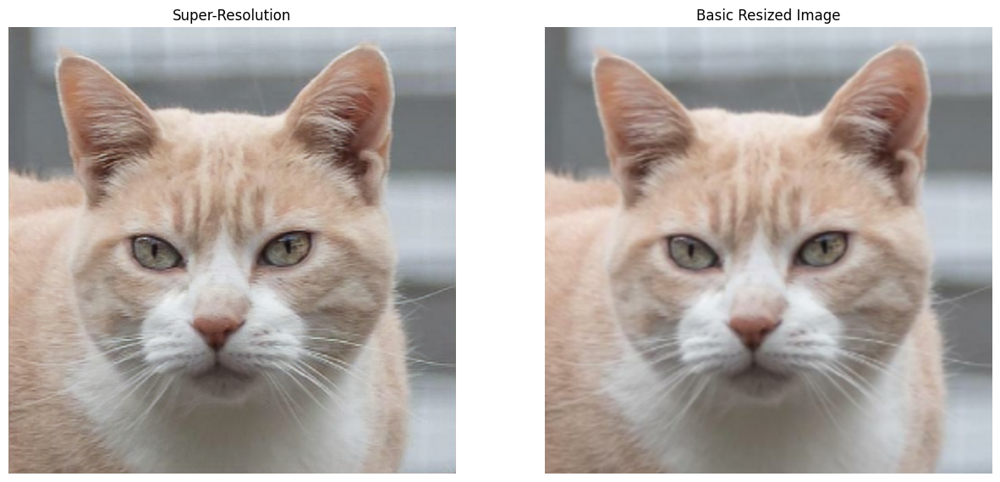

LR Image Shape: (256, 256, 3)
HR Image Shape: (512, 512, 3)


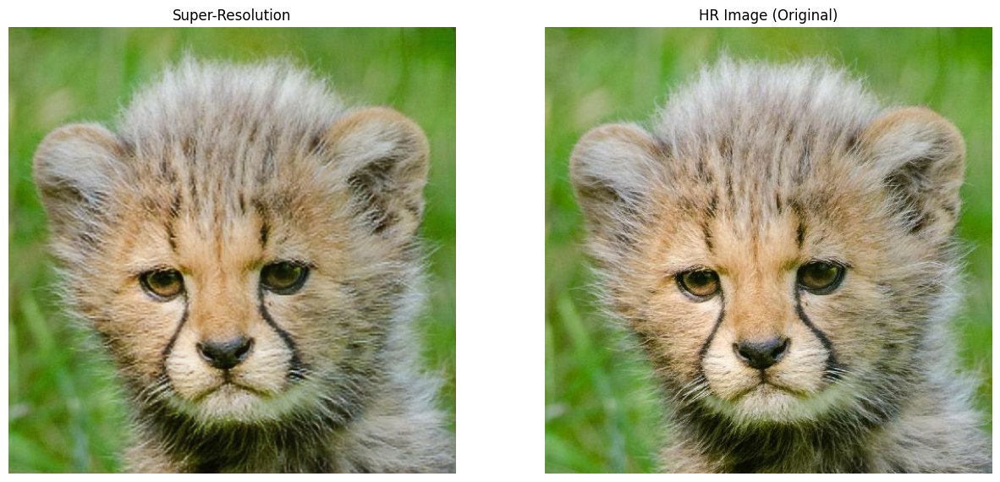

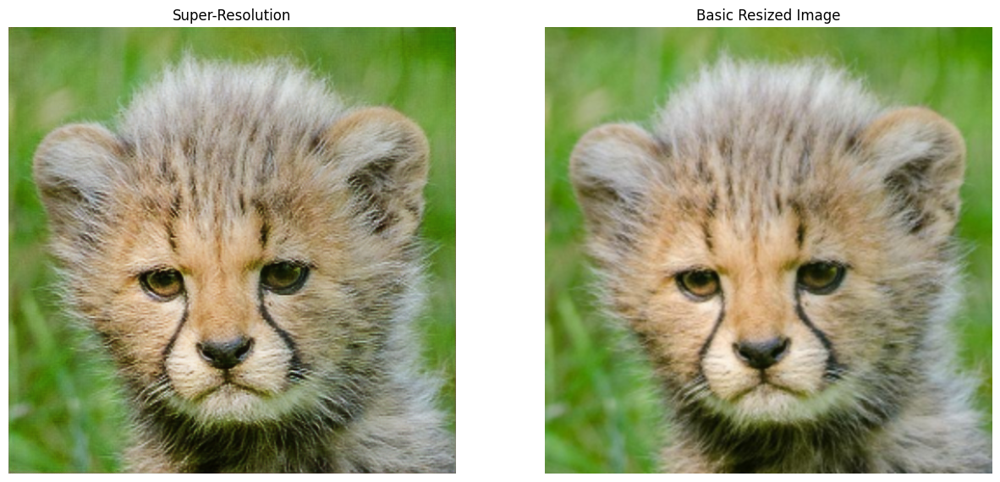

LR Image Shape: (256, 256, 3)
HR Image Shape: (512, 512, 3)


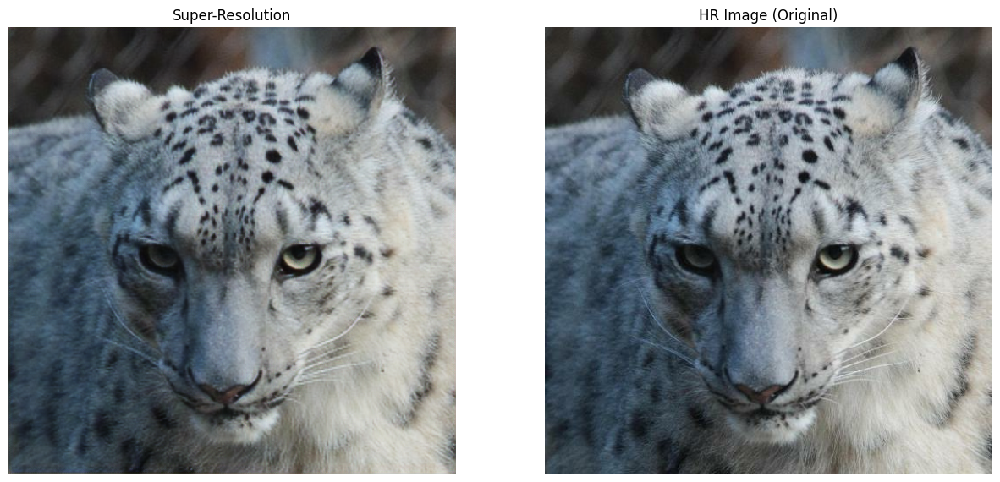

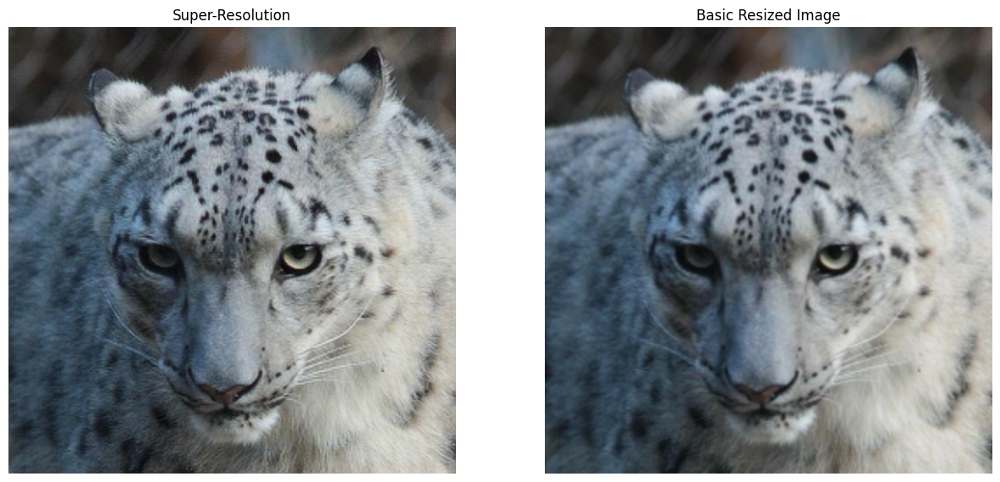

LR Image Shape: (256, 256, 3)
HR Image Shape: (512, 512, 3)


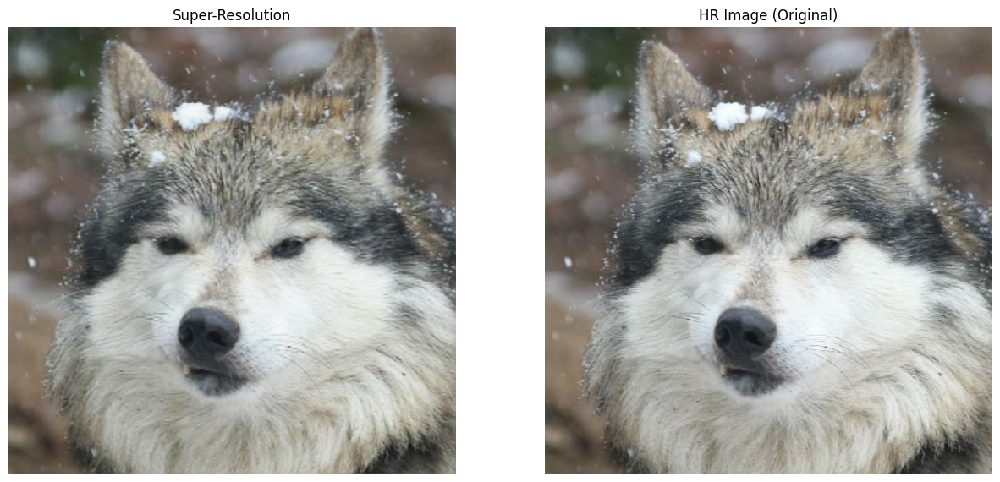

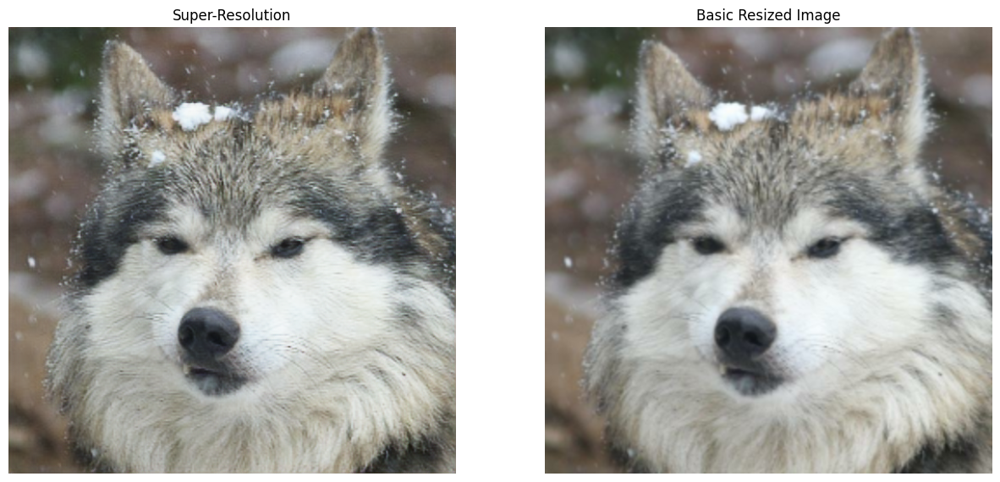

LR Image Shape: (256, 256, 3)
HR Image Shape: (512, 512, 3)


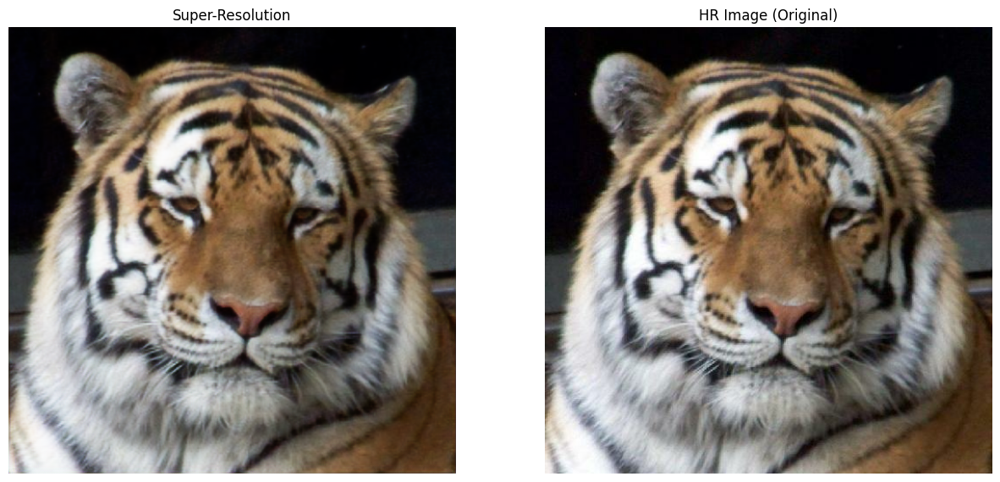

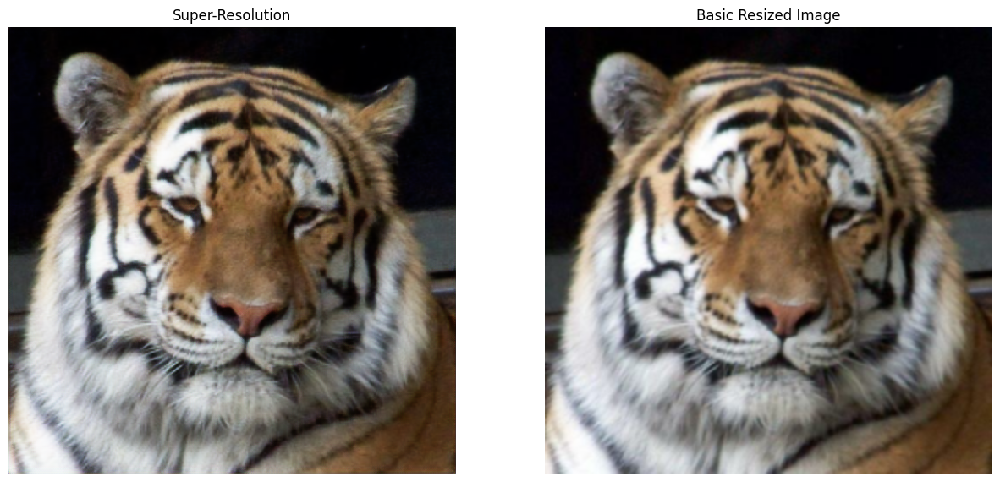

LR Image Shape: (256, 256, 3)
HR Image Shape: (512, 512, 3)


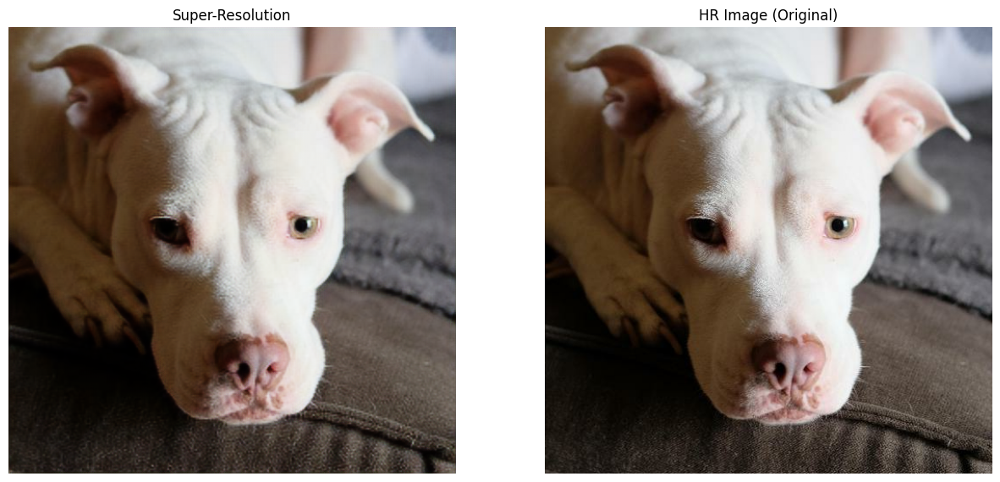

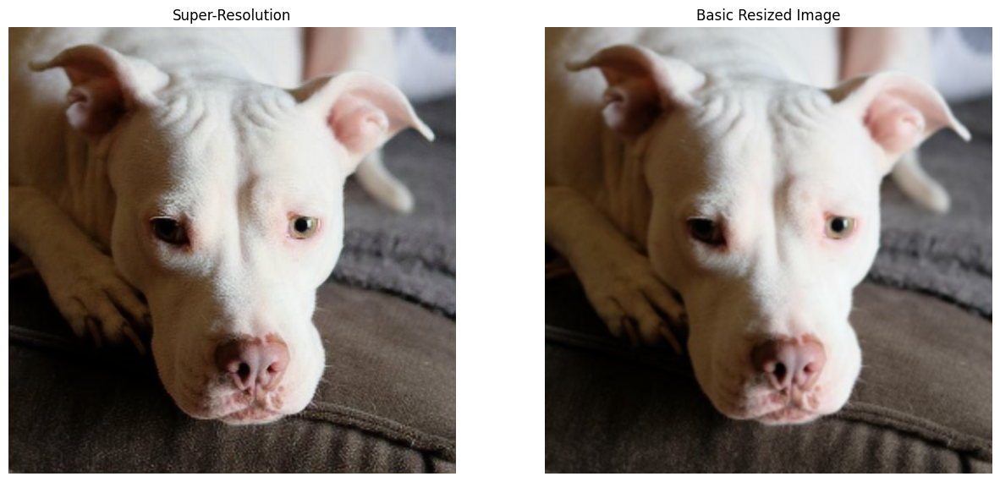

LR Image Shape: (256, 256, 3)
HR Image Shape: (512, 512, 3)


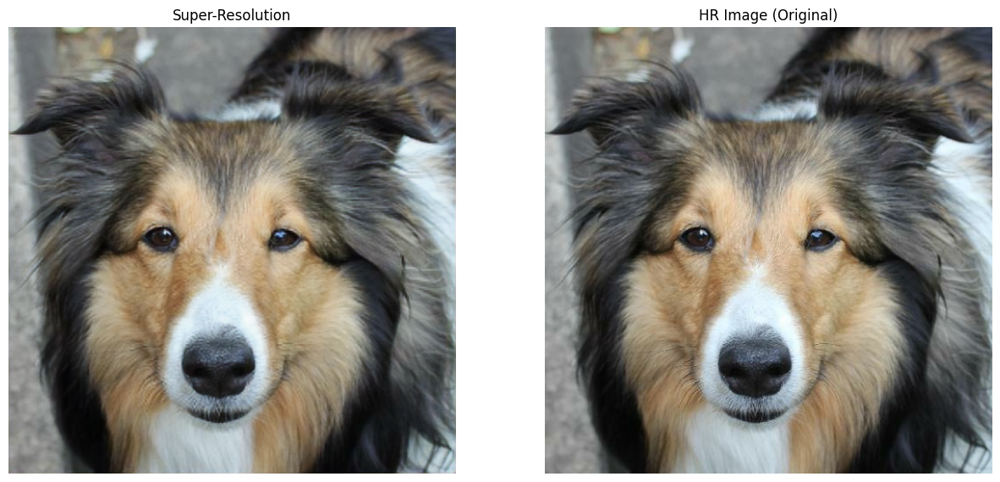

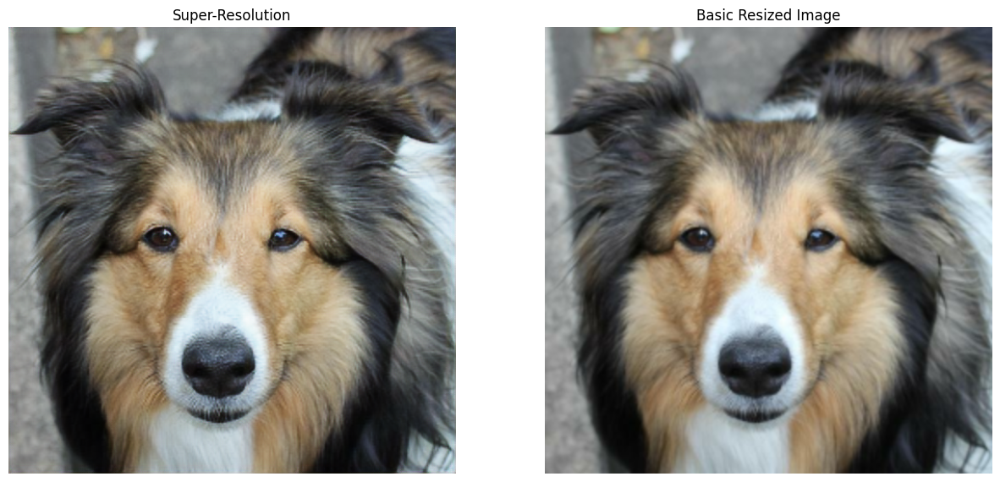

LR Image Shape: (256, 256, 3)
HR Image Shape: (512, 512, 3)


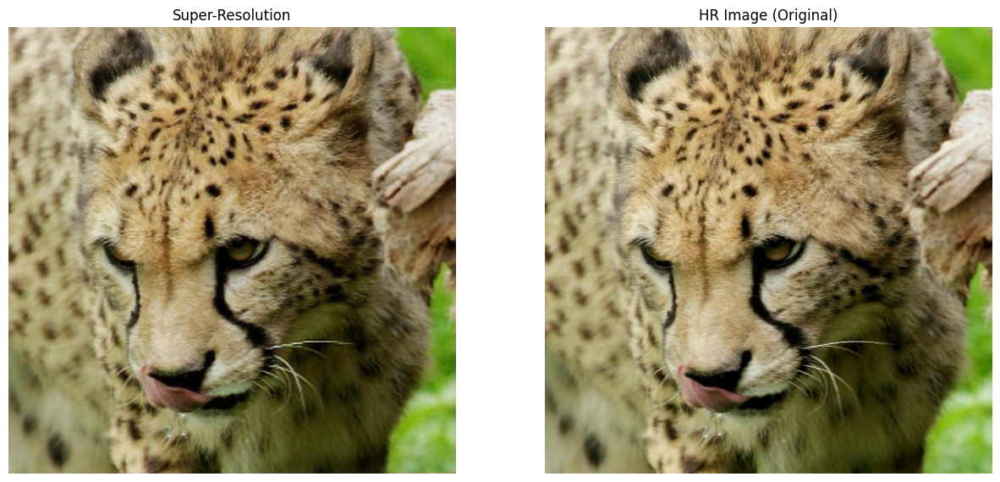

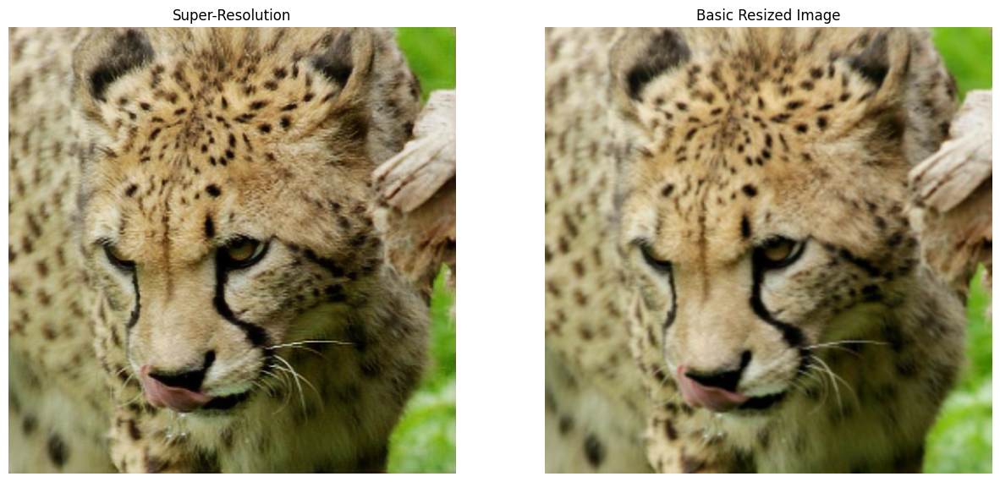

In [ ]:
for lr_images, hr_images in val_dataset.take(1):
    for i in range(8):
      lr_image = lr_images[i]
      hr_image = hr_images[i]
      print("LR Image Shape:", lr_image.shape)
      print("HR Image Shape:", hr_image.shape)


      sr_image = generator(tf.expand_dims(lr_image, axis=0), training=False)
      lr_image_numpy = lr_image.numpy()
      basic_sr_image = cv2.resize(lr_image_numpy, (512, 512))


      sr_image = tf.squeeze(sr_image, axis=0).numpy()

      fig, axs = plt.subplots(1, 2, figsize=(15, 7))


      axs[0].imshow(sr_image)
      axs[0].set_title("Super-Resolution")
      axs[0].axis("off")


      axs[1].imshow(hr_image)
      axs[1].set_title("HR Image (Original)")
      axs[1].axis("off")

      plt.show()


      fig, axs = plt.subplots(1, 2, figsize=(15, 7))


      axs[0].imshow(sr_image)
      axs[0].set_title("Super-Resolution")
      axs[0].axis("off")


      axs[1].imshow(basic_sr_image)
      axs[1].set_title("Basic Resized Image")
      axs[1].axis("off")

      plt.show()


### Conclusions
To the human eye , it seems to perform much better than the  interliner approximation, which is "Basic resized Image" on the plots. the details are much better preserved, especially on the focused and not dim parts of the image one can see clear difference. The sharpness and depth are much better estimated with the esrgan than with the interlinear approximation. From the cons, The colors may be slightly misrepresented comparing to the original high resolution image, maybe the first layer of the generator could have more channels to capture the colors information better. Additionaly in the most difficult patches, so the high detailed fur fragments , we can see additional noise builds up.

### Superesolution examples

Here we present another examples for comparison and another ways of comparison - we calculate the PSNR(peak signal to noise ratio) to have some quantative comparison between the basic interlinear upscaling and the network performance apart from the qualitative visible with the bear eye

LR Image Shape: (256, 256, 3)
HR Image Shape: (512, 512, 3)
PSNR for Super-Resolution: 27.6932 dB
PSNR for Basic Resized Image: 28.5006 dB


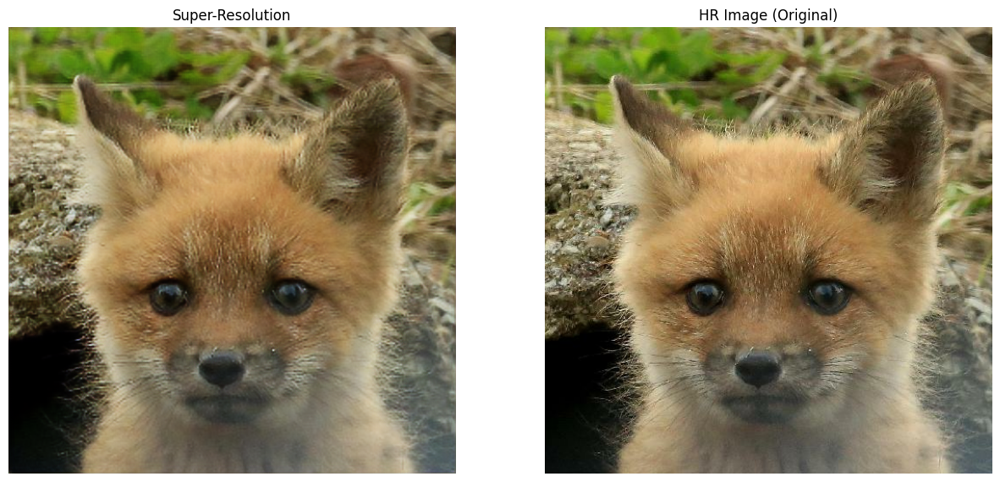

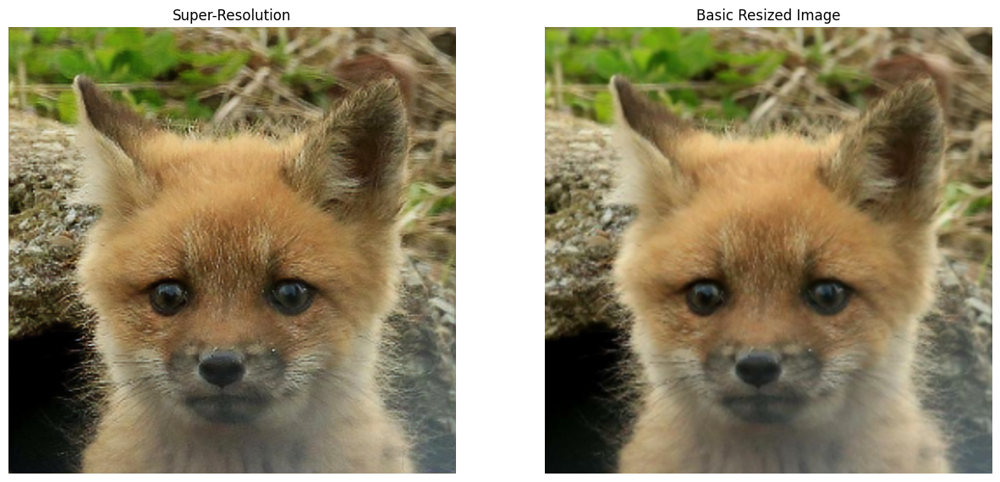

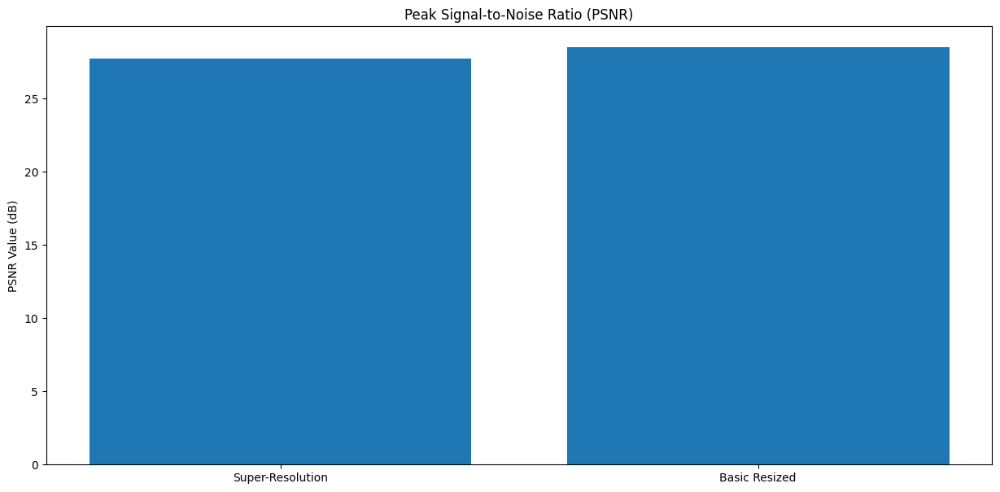

LR Image Shape: (256, 256, 3)
HR Image Shape: (512, 512, 3)
PSNR for Super-Resolution: 28.0620 dB
PSNR for Basic Resized Image: 29.1537 dB


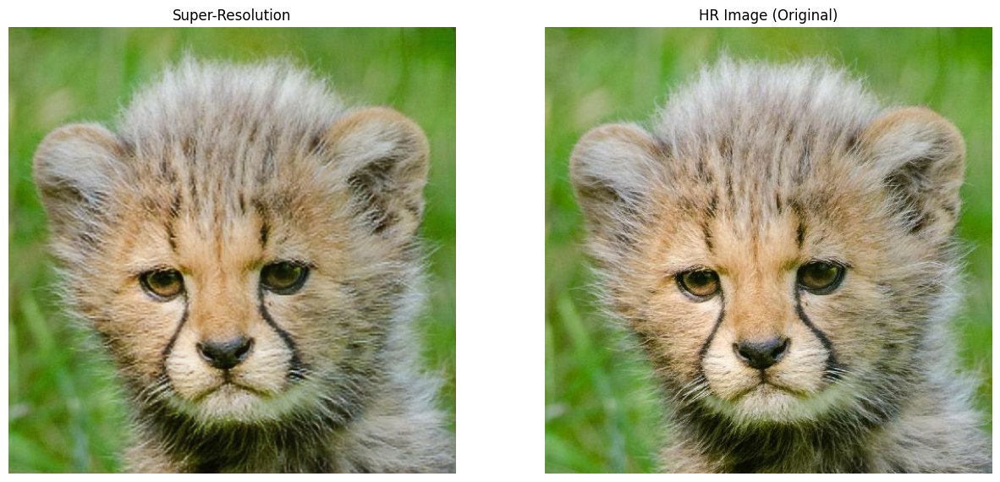

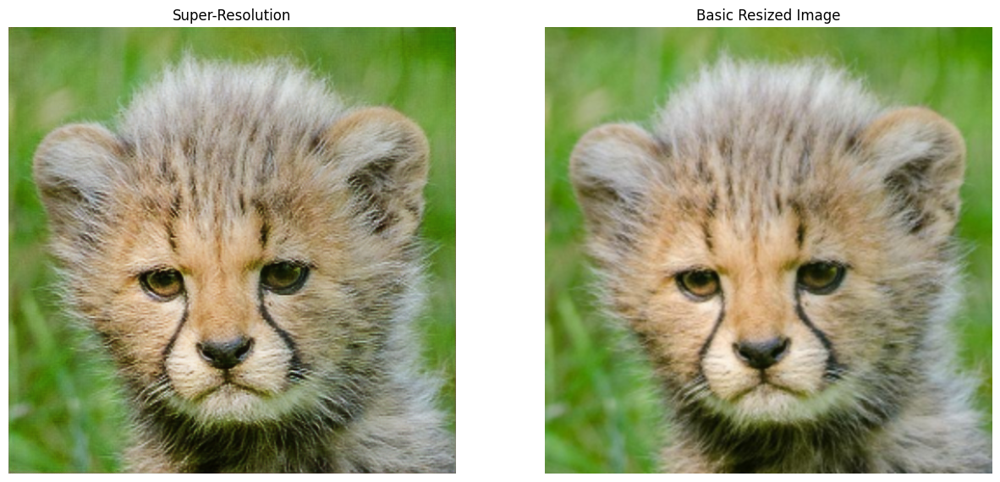

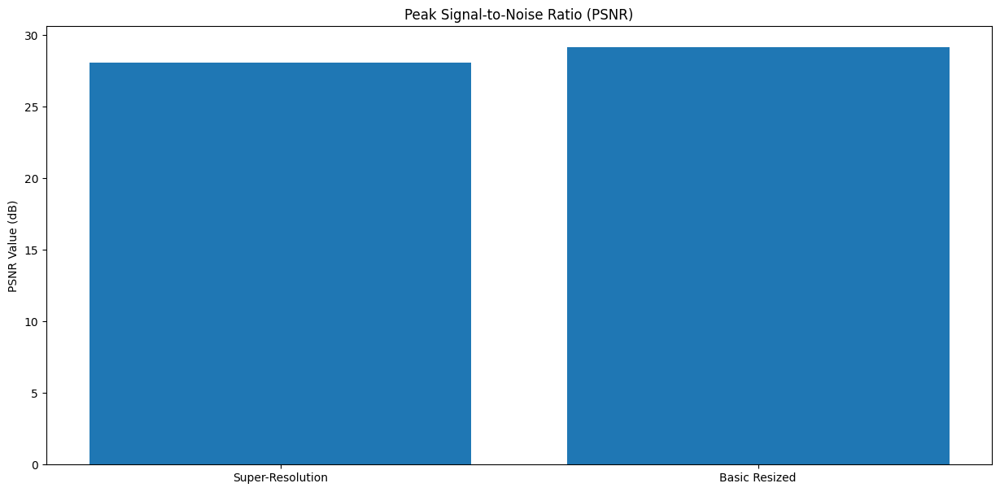

LR Image Shape: (256, 256, 3)
HR Image Shape: (512, 512, 3)
PSNR for Super-Resolution: 33.0421 dB
PSNR for Basic Resized Image: 34.5252 dB


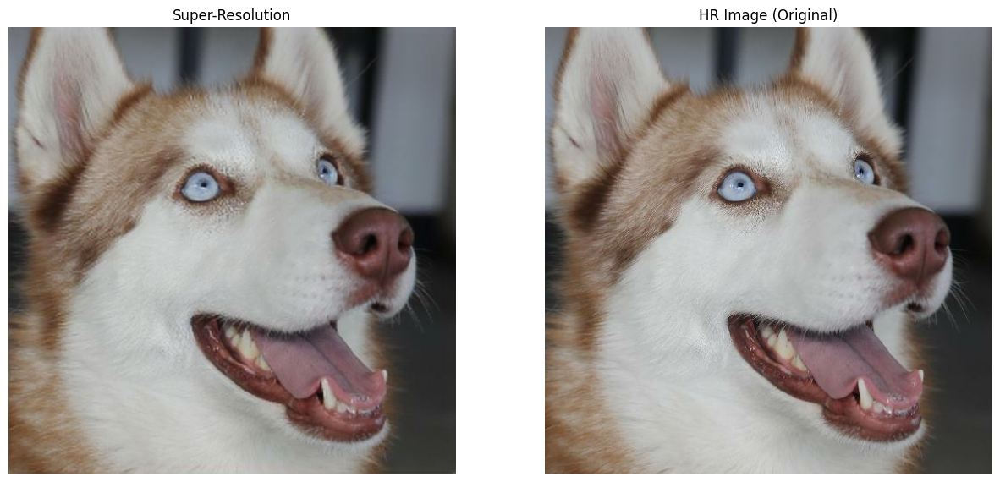

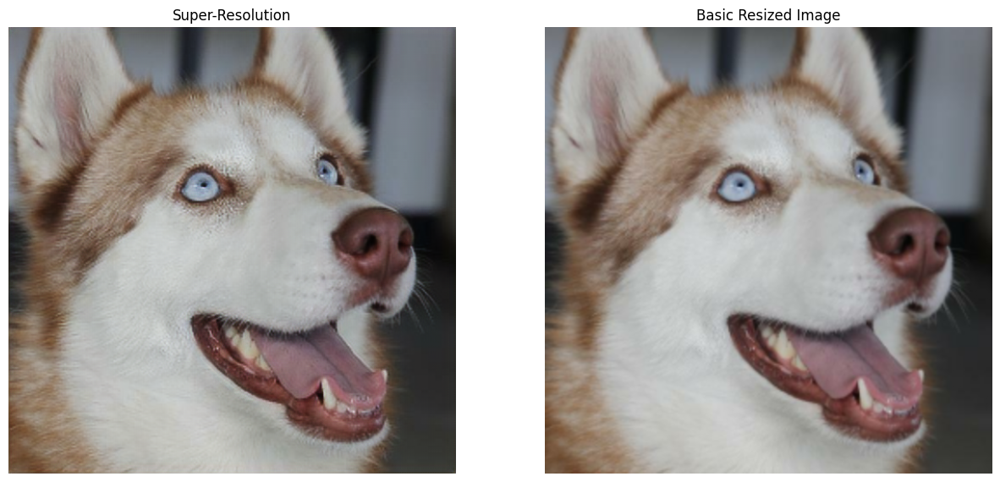

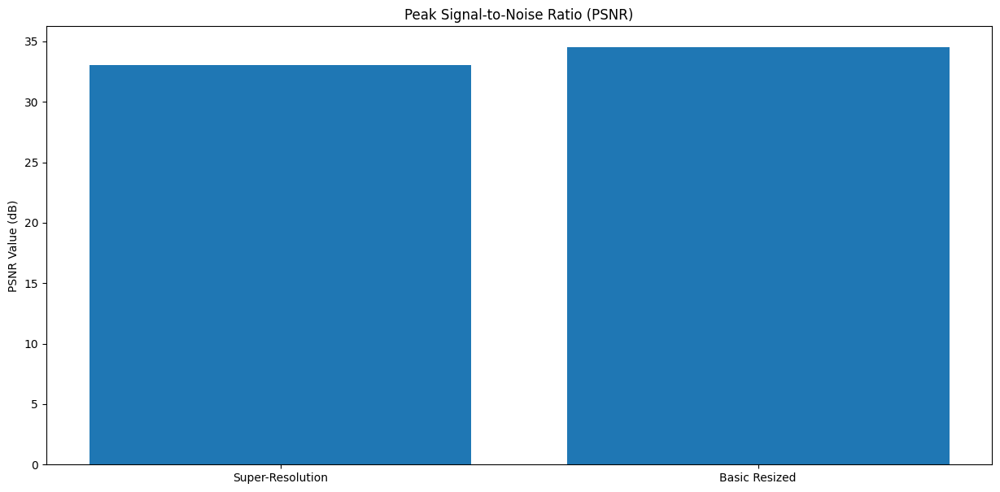

LR Image Shape: (256, 256, 3)
HR Image Shape: (512, 512, 3)
PSNR for Super-Resolution: 32.8830 dB
PSNR for Basic Resized Image: 34.2279 dB


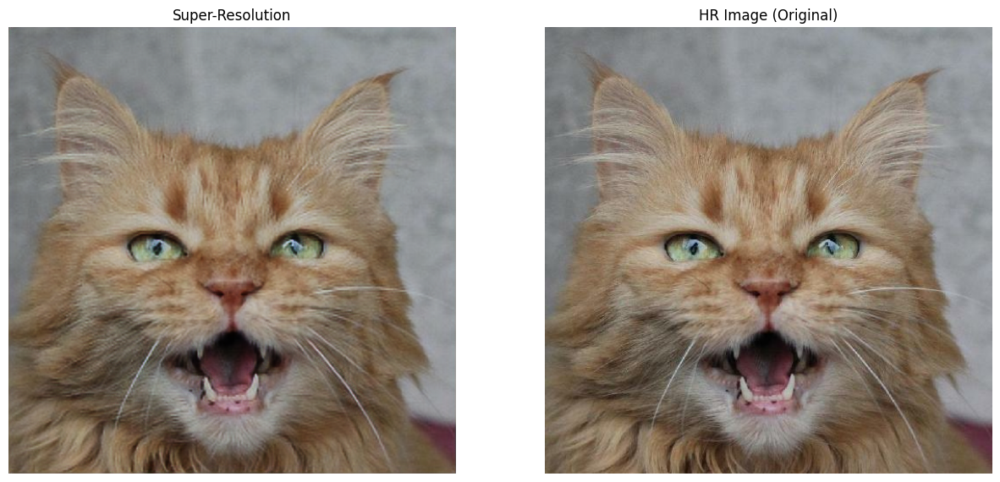

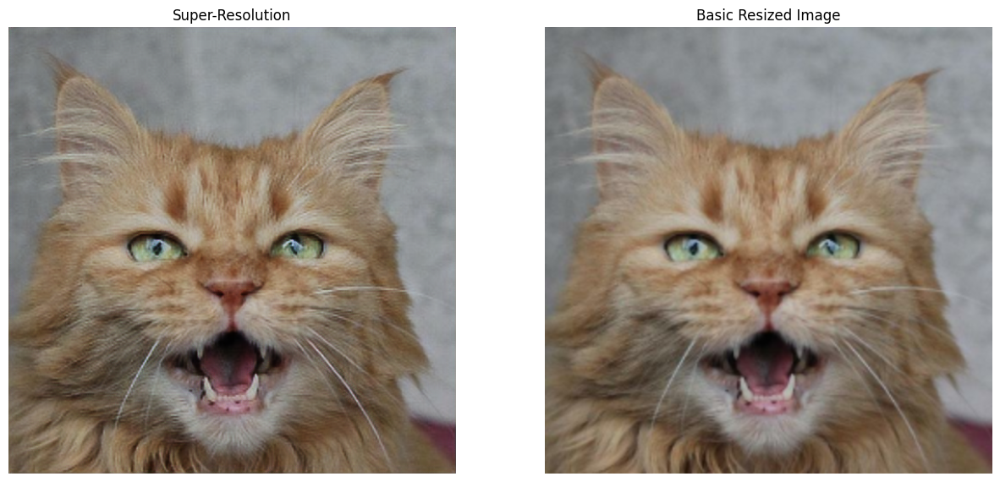

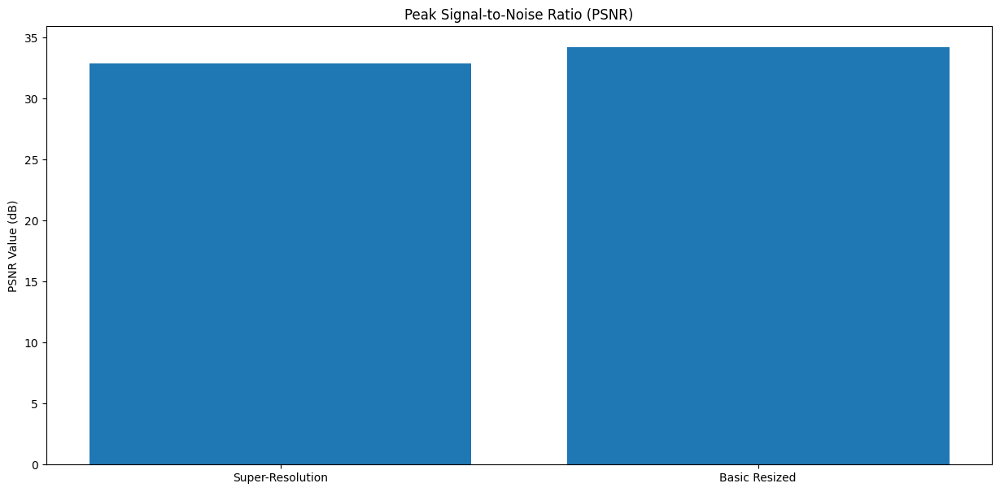

LR Image Shape: (256, 256, 3)
HR Image Shape: (512, 512, 3)
PSNR for Super-Resolution: 26.6603 dB
PSNR for Basic Resized Image: 27.1803 dB


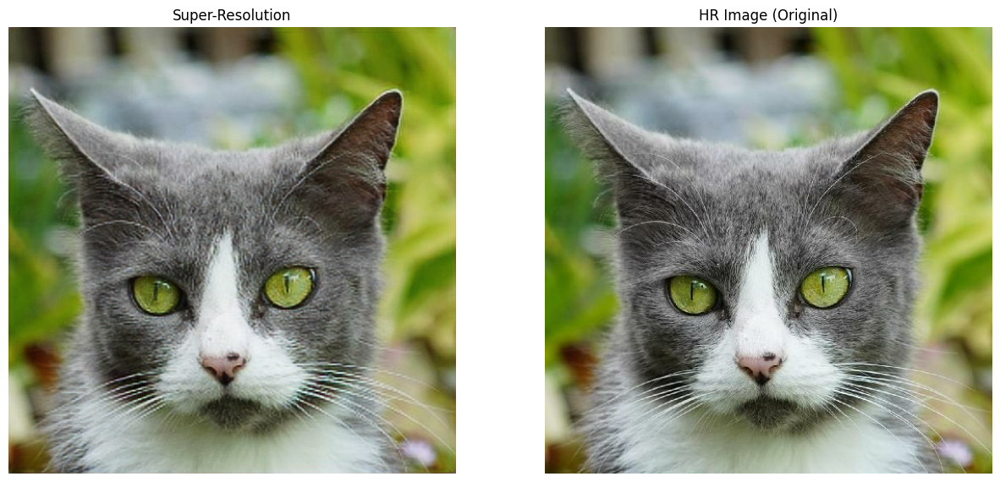

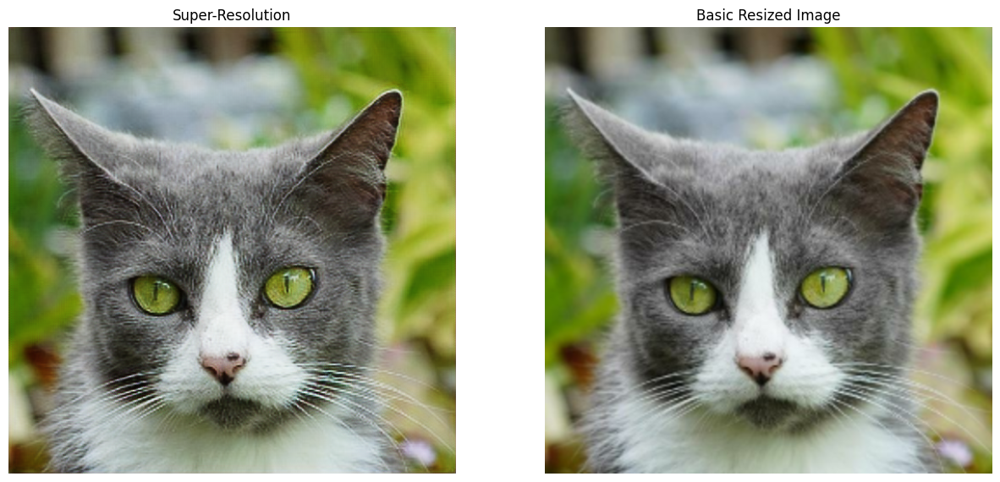

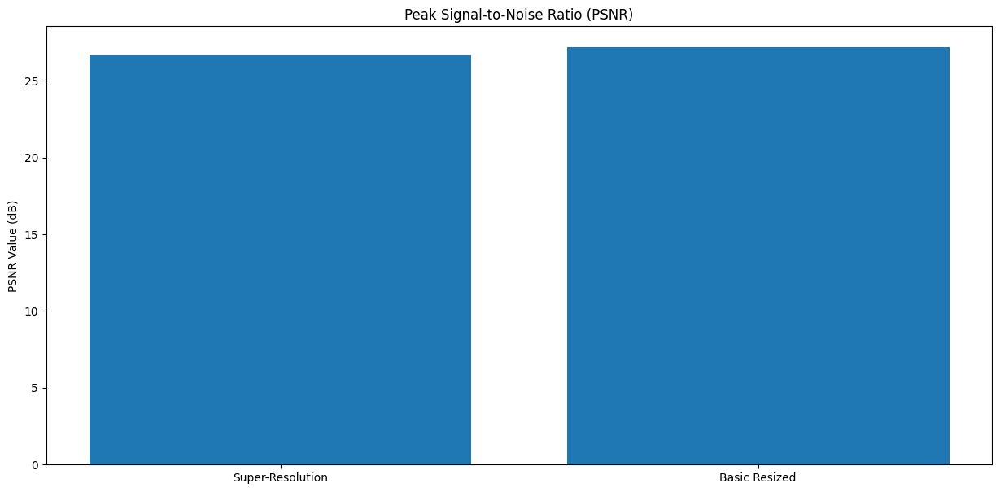

LR Image Shape: (256, 256, 3)
HR Image Shape: (512, 512, 3)
PSNR for Super-Resolution: 22.4664 dB
PSNR for Basic Resized Image: 22.6138 dB


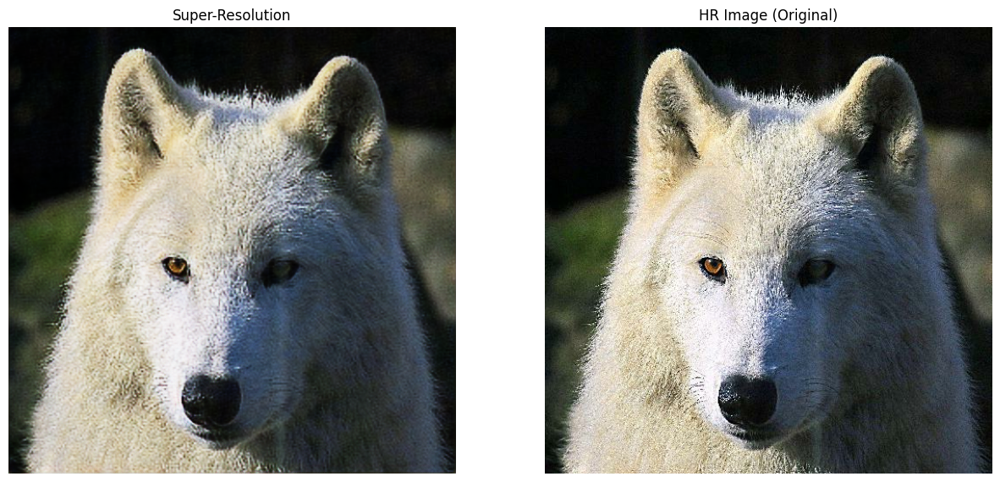

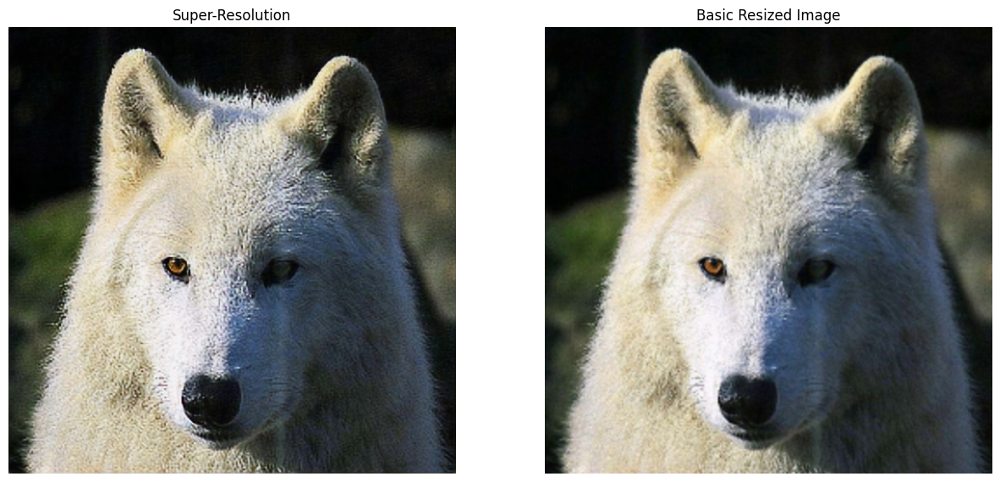

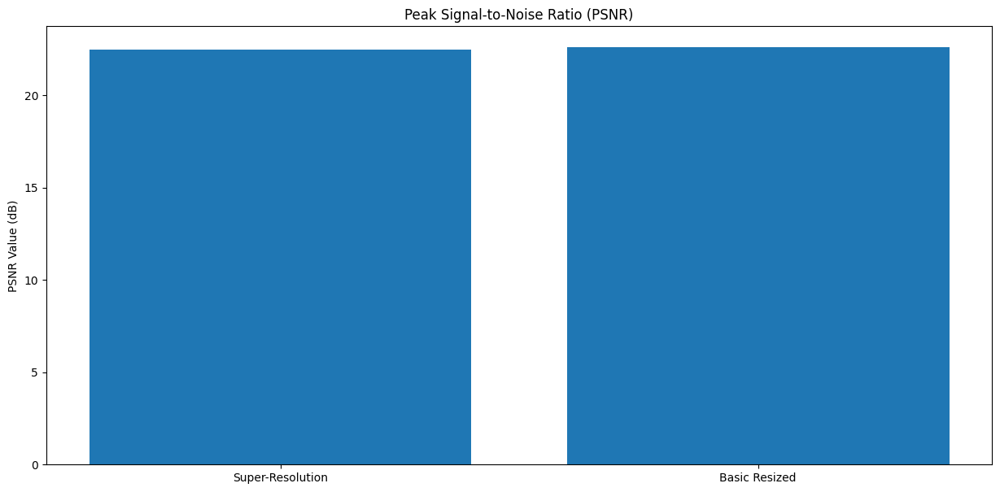

LR Image Shape: (256, 256, 3)
HR Image Shape: (512, 512, 3)
PSNR for Super-Resolution: 35.0287 dB
PSNR for Basic Resized Image: 43.0929 dB


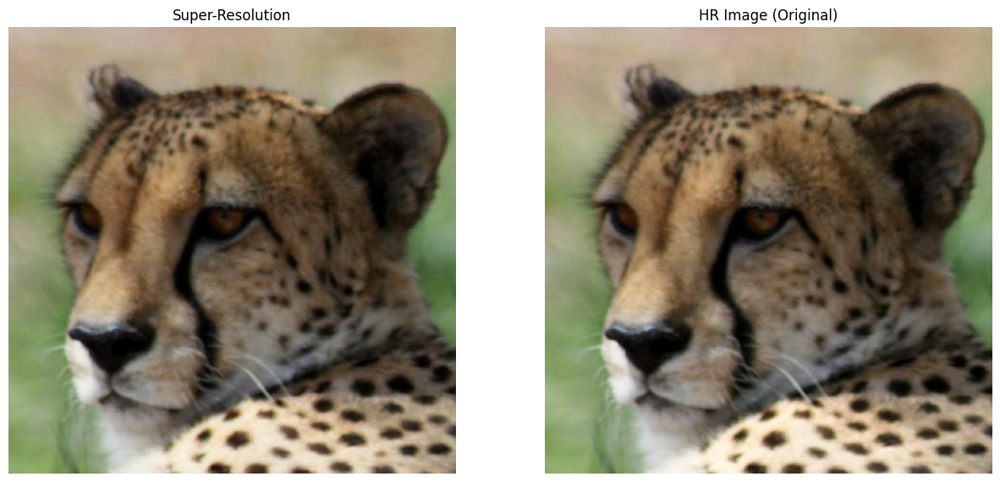

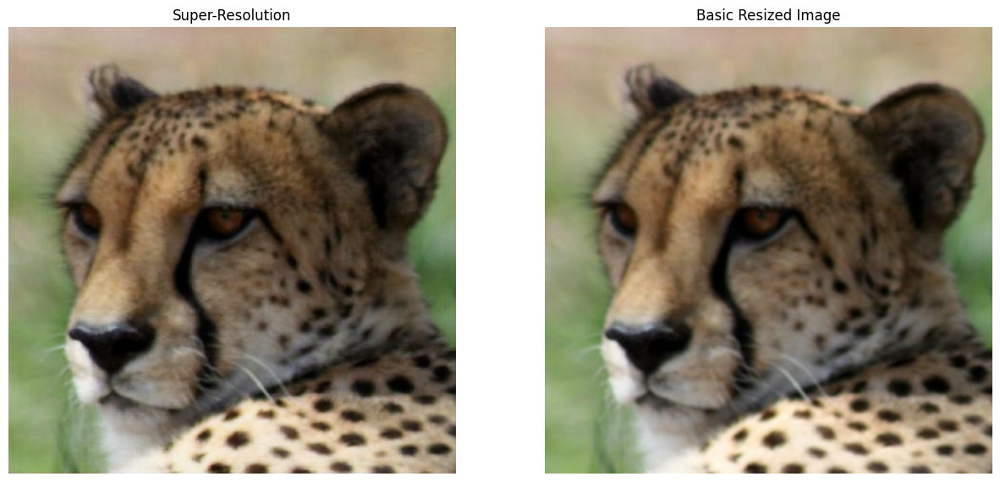

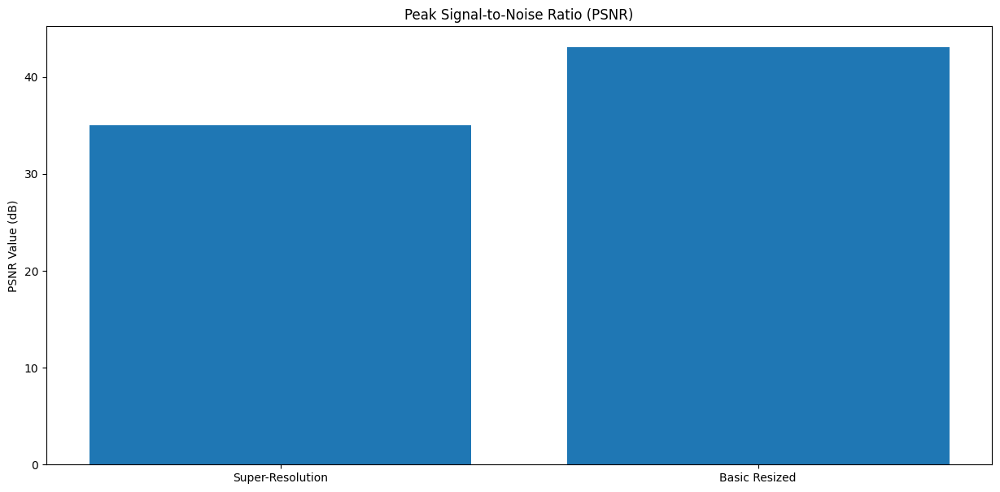

LR Image Shape: (256, 256, 3)
HR Image Shape: (512, 512, 3)
PSNR for Super-Resolution: 30.3682 dB
PSNR for Basic Resized Image: 31.9105 dB


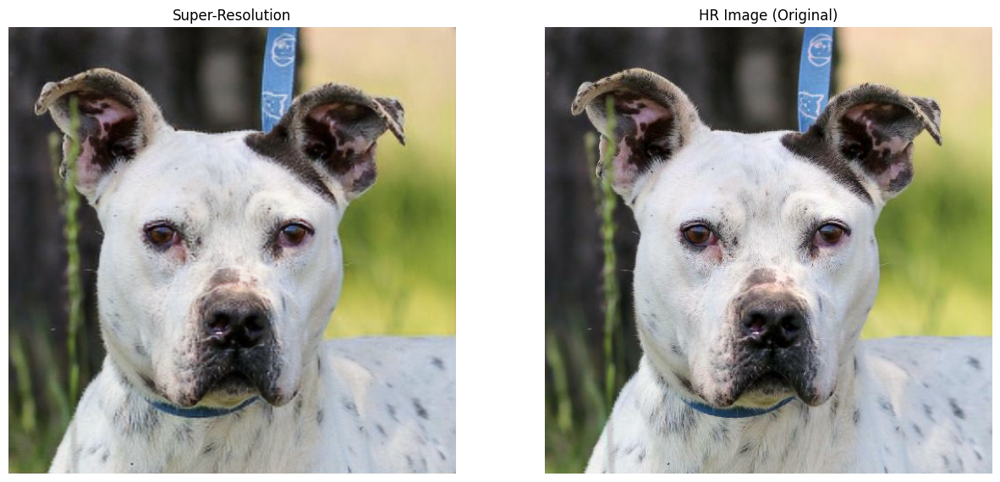

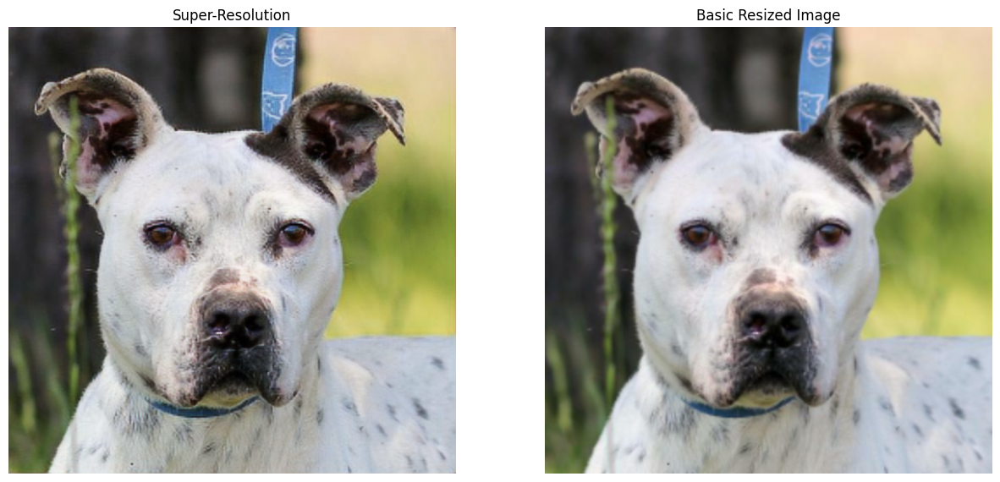

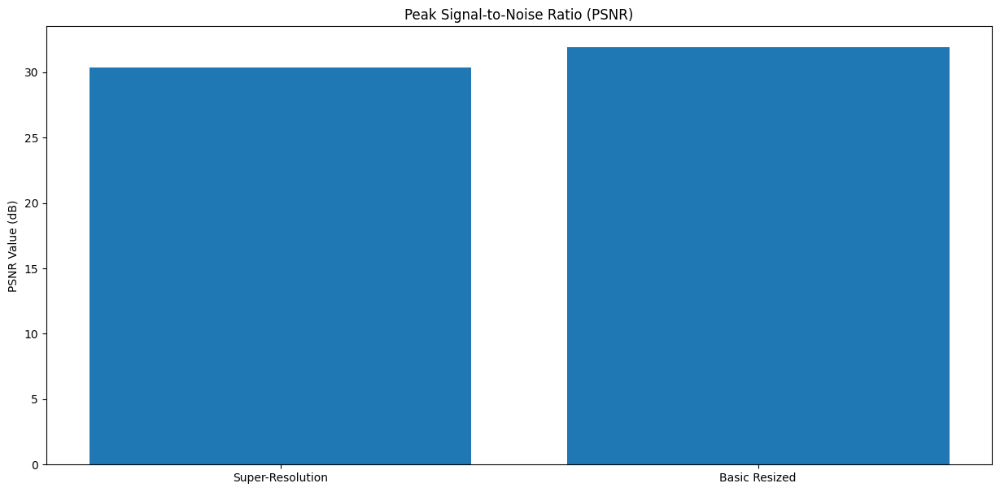

In [ ]:
import numpy as np
import tensorflow as tf
import cv2
import matplotlib.pyplot as plt
from skimage.metrics import peak_signal_noise_ratio as psnr


def mean_absolute_error(pred, truth):
    return np.mean(np.abs(pred - truth))


def calculate_psnr(pred, truth):
    return psnr(truth, pred)


for lr_images, hr_images in val_dataset.take(1):
    for i in range(8):
        lr_image = lr_images[i]
        hr_image = hr_images[i]

        print("LR Image Shape:", lr_image.shape)
        print("HR Image Shape:", hr_image.shape)


        sr_image = generator(tf.expand_dims(lr_image, axis=0), training=False)


        lr_image_numpy = lr_image.numpy()
        basic_sr_image = cv2.resize(lr_image_numpy, (512, 512))
        sr_image = tf.squeeze(sr_image, axis=0).numpy()



        psnr_sr = calculate_psnr(sr_image, hr_image.numpy())
        psnr_basic = calculate_psnr(basic_sr_image, hr_image.numpy())


        print(f"PSNR for Super-Resolution: {psnr_sr:.4f} dB")
        print(f"PSNR for Basic Resized Image: {psnr_basic:.4f} dB")


        fig, axs = plt.subplots(1, 2, figsize=(15, 7))


        axs[0].imshow(sr_image)
        axs[0].set_title("Super-Resolution")
        axs[0].axis("off")


        axs[1].imshow(hr_image)
        axs[1].set_title("HR Image (Original)")
        axs[1].axis("off")

        plt.show()


        fig, axs = plt.subplots(1, 2, figsize=(15, 7))

        axs[0].imshow(sr_image)
        axs[0].set_title("Super-Resolution")
        axs[0].axis("off")

        axs[1].imshow(basic_sr_image)
        axs[1].set_title("Basic Resized Image")
        axs[1].axis("off")

        plt.show()

        fig, axs = plt.subplots(1, 1, figsize=(15, 7))


        axs.bar(["Super-Resolution", "Basic Resized"], [psnr_sr, psnr_basic])
        axs.set_title("Peak Signal-to-Noise Ratio (PSNR)")
        axs.set_ylabel("PSNR Value (dB)")

        plt.show()


### Conclusions

The simple interlinear scaling achieved generally higher(better) psnr values, which is probably caused by the excess of the noise in the esrgan generated upscaling. However qualitatively it is clearly seen , especially on the  high resolution images with good focus and great details that the superesolution with esrgan produces much sharper and rich in details images.